# imports

In [1]:
def warn(*args, **kwargs):
    pass
import warnings
warnings.warn = warn

from SEAM.utils import *
import SEAM
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import cv2
from scipy.spatial import distance_matrix
from sklearn.decomposition import PCA

from scipy.spatial.distance import *

Using TensorFlow backend.


# settings

In [2]:
sns.set_style('white')
# font = {'family' : 'normal',
#         'weight' : 'bold',
#         'size'   : 2}

# matplotlib.rc('font', **font)
# matplotlib.rcParams.update({'font.size': 2})

import matplotlib.pyplot as plt

SMALL_SIZE = 8
MEDIUM_SIZE = 10
BIGGER_SIZE = 12

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title




# tiff_path = '/home/yzy/PUBDT/st/MIBI/BC/tiff/'
# seg_path = '/home/yzy/PUBDT/st/MIBI/BC/segmentation_mask/'
# h5ad_path = '/home/yzy/PUBDT/st/MIBI/BC/h5ad/'

# var_list = ['Au','Background','Beta catenin','Ca','CD11b','CD11c','CD138','CD16',
#            'CD20','CD209','CD3','CD31','CD4','CD45','CD45RO','CD56','CD63','CD68',
#            'CD8','dsDNA','EGFR','Fe','FoxP3','H3K27Me3','H3K9ac','HLA-DR','HLA_Class_1',
#            'IDO','Keratin17','Keratin6','Ki67','Lag3','MPO','Na','P','p53','Pan-Keratin',
#            'PD-L1','PD1','phospho-S6','Si','SMA','Ta','Vimentin']

# protein_list = ['Beta catenin','CD11b','CD11c','CD138','CD16',
#            'CD20','CD209','CD3','CD31','CD4','CD45','CD45RO','CD56','CD63','CD68',
#            'CD8','dsDNA','EGFR','FoxP3','H3K27Me3','H3K9ac','HLA-DR','HLA_Class_1',
#            'IDO','Keratin17','Keratin6','Ki67','Lag3','MPO','p53','Pan-Keratin',
#            'PD-L1','PD1','phospho-S6','SMA','Vimentin']


image_size = 2048
# SEAM.settings.IMG_SZ1 = 2048
# SEAM.settings.IMG_SZ2 = 2048

# functions

In [3]:
from PIL import Image
import numpy as np

def read_tiff(path):
    """
    path - Path to the multipage-tiff file
    """
    img = Image.open(path)
    images = []
    for i in range(img.n_frames):
        img.seek(i)
        images.append(np.array(img))
    return np.array(images)



def get_MIBI_adata(patient_no):
# patient_no = 16
    cur_tif_file = tiff_path+'TA459_multipleCores2_Run-4_Point{0}.tiff'.format(patient_no)
    tiff = read_tiff(cur_tif_file)

    seg_file = seg_path+'TA459_multipleCores2_Run-4_Point{0}_Overlay.png'.format(patient_no)
    img = cv2.imread(seg_file)

    img_0 = img[:,:,0]

    import skimage
    from skimage.viewer.viewers import ImageViewer
    mask = img_0 > 200


    labeled_image = skimage.measure.label(mask, connectivity=2, return_num=True)[0]


    plt.imshow(img)
    plt.title('original')
    plt.show()
    plt.imshow(mask)
    plt.title('binary mask')
    plt.show()
    plt.imshow(labeled_image)
    plt.title('labeled image')
    plt.show()


    var_list = ['Au','Background','Beta catenin','Ca','CD11b','CD11c','CD138','CD16',
               'CD20','CD209','CD3','CD31','CD4','CD45','CD45RO','CD56','CD63','CD68',
               'CD8','dsDNA','EGFR','Fe','FoxP3','H3K27Me3','H3K9ac','HLA-DR','HLA_Class_1',
               'IDO','Keratin17','Keratin6','Ki67','Lag3','MPO','Na','P','p53','Pan-Keratin',
               'PD-L1','PD1','phospho-S6','Si','SMA','Ta','Vimentin']


    cell_num = labeled_image.max()
    cell_pixel_dict = {}
    cell_pos_dict = {}
    # key：cellidx（1开始）；value：numpy matrix，num_pixels*num_vars
    for i in range(labeled_image.shape[0]):
        for j in range(labeled_image.shape[1]):
            cur_label = labeled_image[i,j]
            cur_pixel_profile = tiff[:,i,j]
            if cur_label==0:
                continue
            if cur_label not in cell_pixel_dict:
                cell_pixel_dict[cur_label] = [cur_pixel_profile]
                cell_pos_dict[cur_label] = [np.array([i,j])]
            else:
                cell_pixel_dict[cur_label].append(cur_pixel_profile)
                cell_pos_dict[cur_label].append(np.array([i,j]))

    for cell_idx in cell_pixel_dict.keys():
        cell_pixel_dict[cell_idx] = np.vstack(cell_pixel_dict[cell_idx])
        cell_pos_dict[cell_idx] = np.vstack(cell_pos_dict[cell_idx])


    X_mat = []
    spatial_mat = []
    cell_size_mat = []
    for cell_idx in cell_pixel_dict:
        cur_X = np.mean(cell_pixel_dict[cell_idx],axis=0)
        cur_spatial = np.mean(cell_pos_dict[cell_idx],axis=0)
        cur_cell_size = cell_pixel_dict[cell_idx].shape[0]
        X_mat.append(cur_X)
        spatial_mat.append(cur_spatial)
        cell_size_mat.append(cur_cell_size)
    X_mat = np.vstack(X_mat)
    spatial_mat = np.vstack(spatial_mat)
    cell_size_mat = np.array(cell_size_mat)

    X_mat = np.arcsinh(X_mat)

    adata = ad.AnnData(X = X_mat,var=pd.DataFrame(index=var_list))

    adata.obsm['spatial'] = spatial_mat
    adata.obs['cell_size'] = cell_size_mat


    sc.pl.embedding(adata,basis='spatial',
                    color=['cell_size','SMA','Beta catenin','CD11b'],
                   ncols=2,
                   s=50)
    return adata


def SIMSID_prepare(a,sample_size=10):
#     sample_size = 10
    row_idx_list = []

    for i in range(a.shape[0]):
        cur_cell_idx = i+1
        cur_matrow_idx = np.where(a.uns['cell_idx']==cur_cell_idx)[0]

    #         when current cell size is bigger than sample size, choose without replace      
        cur_matrow_idx_sample = np.random.choice(cur_matrow_idx, sample_size, replace=(cur_matrow_idx.shape[0]<sample_size))
        row_idx_list.append(cur_matrow_idx_sample)

    row_idx = np.hstack(row_idx_list)
    train_x_sample = a.uns['train_x'][row_idx,:]
    cell_idx_sample = a.uns['cell_idx'][row_idx]
    a.uns['train_x_sample'] = train_x_sample
    a.uns['cell_idx_sample'] = cell_idx_sample
    
def prepare_adata_for_SIMSID(img_mat,segment_mat,var_names):

    # prepare cell_pos
    cell_pos = np.where(segment_mat.flatten()!=0)[0]

    # prepare cell_idx
    cell_idx = np.zeros_like(cell_pos)
    cell_idx_raw = segment_mat[segment_mat!=0]
    cell_idx_raw_unique = np.unique(cell_idx_raw)
    cell_idx_raw_unique_sort = np.sort(cell_idx_raw_unique)
    for cir in range(len(cell_idx_raw)):
        cur_true_idx = np.where(cell_idx_raw_unique_sort==cell_idx_raw[cir])[0][0]
        cell_idx[cir]=cur_true_idx

    cell_idx+=1

    # prepare train_x
    train_x_raw = img_mat.reshape(img_mat.shape[0],-1).transpose()
    train_x = train_x_raw[cell_pos,:]

    # prepare IMS
    IMS = img_mat.reshape(img_mat.shape[0],-1).transpose()


    # prepare sc_mat
    sc_mat = np.zeros(shape=(cell_idx.max(),img_mat.shape[0]))
    for i in range(sc_mat.shape[0]):
        cur_pixels = train_x[cell_idx==i+1,:]
        cur_sum = np.mean(cur_pixels,axis=0)
        sc_mat[i,:] = cur_sum

    adata_sc = ad.AnnData(X=sc_mat)
    adata_sc.var_names = var_names
    adata_sc.uns['cell_pos'] = cell_pos
    adata_sc.uns['cell_idx'] = cell_idx
    adata_sc.uns['train_x'] = train_x
    adata_sc.uns['IMS'] = IMS
    # adata_sc.var_names = 
    return adata_sc

# a_use = tmp
# use_rep = 'X_pca'
# cls_use = 'annotation'
def WBR_adata(a_use,use_rep,cls_use):
    dist_mat = squareform(pdist(a_use.obsm[use_rep]))
    cls_array = np.array(a_use.obs[cls_use])
    within_list = []
    between_list = []
    for i in range(dist_mat.shape[0]):
        for j in range(dist_mat.shape[1]):    
            i_cls = cls_array[i]
            j_cls = cls_array[j]
            if i_cls==j_cls:
                within_list.append(dist_mat[i,j])
            else:
                between_list.append(dist_mat[i,j])
    within_mean = np.mean(within_list)
    between_mean = np.mean(between_list)
    WBR = within_mean/between_mean
    return WBR



def KNN_adata(a_use,cls_use,rep_use,test_ratio):
    test_ratio/=100
    
#     n_fold = int(1/train_ratio)
    n_fold = int(1/test_ratio)
    kf = StratifiedKFold(n_splits=n_fold,shuffle=True)
    knn = KNeighborsClassifier(metric='euclidean')
    cur_rst=cross_val_score(knn, a_use.obsm[rep_use], a_use.obs[cls_use], scoring='accuracy',cv=kf,verbose=0)
    rst = np.mean(cur_rst)
    
    print('{0}, KNN accuracy: {1}'.format(rep_use,rst))
    return rst


def SVM_adata(a_use,cls_use,rep_use,test_ratio):
    test_ratio/=100
    
    n_fold = int(1/test_ratio)
    
    kf = StratifiedKFold(n_splits=n_fold,shuffle=True)
    svm = SVC(kernel='rbf')
    cur_rst=cross_val_score(svm, a_use.obsm[rep_use], a_use.obs[cls_use], scoring='accuracy',cv=kf,verbose=0)
    
    rst = np.mean(cur_rst)
    print('{0}, SVM accuracy: {1}'.format(rep_use,rst))
    return rst

def RF_adata(a_use,cls_use,rep_use,test_ratio):
    test_ratio/=100
    
    n_fold = int(1/test_ratio)
    kf = StratifiedKFold(n_splits=n_fold,shuffle=True)
    svm_linear = RandomForestClassifier()
    cur_rst_linear=cross_val_score(svm_linear, a_use.obsm[rep_use], a_use.obs[cls_use], scoring='accuracy',cv=kf,verbose=0)
    rst_linear = np.mean(cur_rst_linear)
    print('{0}, RF accuracy: {1}'.format(rep_use,rst_linear))
    return rst_linear

def load_scMEP(Pn,iflog=True):
    print('Point{0} start!'.format(Pn))
#     Pn = 21
    base_path = '/home/yzy/PUBDT/st/MIBI/colorectal_carcinoma/'
    tiff_path = base_path+'scMEP_MIBI_colon_images/'
    segmentation_file = base_path+'segmentation/Point{0}_Label_Map.tiff'

    sc_file = base_path+'scMEP_MIBI_singlecell.csv'
    sc_file_h5ad = base_path+'h5ad/MIBI.h5ad'
    # 1~913
    print('loading processed single cell data...')
    a_sc = sc.read_h5ad(sc_file_h5ad)
    a_sc_test = a_sc[a_sc.obs['point']==str(Pn)].copy()
    del a_sc


    if Pn>=1 and Pn<=20:
        tiff_file = tiff_path+'90de_tumor/Point{0}/'
    elif Pn>=21 and Pn<=40:
        tiff_file = tiff_path+'21d7_tumor/Point{0}/'
    elif Pn>=41 and Pn <=44:
        tiff_file = tiff_path+'d3d3_healthy/Point{0}/'
    elif Pn>=45 and Pn<=58:
        tiff_file = tiff_path+'99c0_healthy/Point{0}/'
        
    print('loading raw tiff data...')

    tiff_mat = []
    protein_list = []
    tiff_file = tiff_file.format(Pn)
    for file in os.listdir(tiff_file):
        tiff = read_tiff(tiff_file+file)
        tiff_mat.append(tiff[0,:])
        cur_protein = file.split('_')[1].split('.')[0]
        protein_list.append(cur_protein)
    segment_mat = read_tiff(segmentation_file.format(Pn))[0,:]
    tiff_mat = np.array(tiff_mat)
    if iflog:
        tiff_mat=np.log1p(tiff_mat)
    

#     start: filter segment_mat according to cell size
    cell_size_range = (a_sc_test.obs['cell_size'].min(),a_sc_test.obs['cell_size'].max())
    for i in range(segment_mat.max()):
        cur_cell_idx = i+1
        cur_cell_pos = np.where(segment_mat==cur_cell_idx)
        if (len(cur_cell_pos[0])>=cell_size_range[0] and len(cur_cell_pos[0])<=cell_size_range[1]):
            continue
        segment_mat[cur_cell_pos[0],cur_cell_pos[1]]=0
    old_cell_idx_unique = np.unique(segment_mat)
    new_cell_idx_unique = np.arange(old_cell_idx_unique.shape[0])
    cell_idx_dict = dict(zip(old_cell_idx_unique,new_cell_idx_unique))

    segment_mat_new = segment_mat.copy()
    for i in range(segment_mat.shape[0]):
        for j in range(segment_mat.shape[1]):
            segment_mat_new[i,j] = cell_idx_dict[segment_mat[i,j]]
    segment_mat = segment_mat_new
#     end: filter segment_mat according to cell size
    
    
    print('spatial matching...')
    segment_mat_rot = np.rot90(segment_mat,3)
    segment_mat_flip = np.flip(segment_mat_rot,axis=1)

    tiff_mat_rot = [np.rot90(t,3) for t in tiff_mat]
    tiff_mat_flip = [np.flip(t,axis=1) for t in tiff_mat_rot]
    tiff_mat_flip = np.array(tiff_mat_flip)
    
    print('data formatting...')
    a_pixel = prepare_adata_for_SIMSID(tiff_mat_flip,segment_mat_flip,protein_list)
    SEAM.tl.Cut(a_pixel)

    cell_size_range = (a_sc_test.obs['cell_size'].min(),a_sc_test.obs['cell_size'].max())
    a_pixel_filtered = a_pixel[np.logical_and(a_pixel.obs['cell_size']>=cell_size_range[0],a_pixel.obs['cell_size']<=cell_size_range[1])]
    print('label matching...')

    spatial_sc = a_sc_test.obsm['spatial']
    spatial_pixel = a_pixel_filtered.obsm['spatial']
    cross_dist_mat = distance_matrix(spatial_pixel,spatial_sc)

    cell_type_source = np.array(a_sc_test.obs['Cluster'])
    match_mat = np.argmin(cross_dist_mat,axis=1)
    cell_match = np.argmin(cross_dist_mat,axis=0)
    cell_type_target = cell_type_source[match_mat]
#     a_pixel_match = a_pixel_filtered[match_mat,:]
    a_pixel_filtered.obs['Cluster'] = cell_type_target
    print('Point{0} done!'.format(Pn))
    return a_pixel_filtered,a_sc_test,cell_match

# scMEP data prepare

## load original data (step by step)

specify data path used in this notebook

data is downloaded according to Hartmann, F. J., et al. (2020). "Single-cell metabolic profiling of human cytotoxic T cells." Nature Biotechnology.


## load original data (wrap up)

In [4]:
Pn=41
a_pixel,a_sc,cell_match = load_scMEP(Pn)

Point41 start!
loading processed single cell data...
loading raw tiff data...
spatial matching...
data formatting...
setting obsm: spatial
label matching...


Trying to set attribute `.obs` of view, copying.


Point41 done!


... storing 'Cluster' as categorical


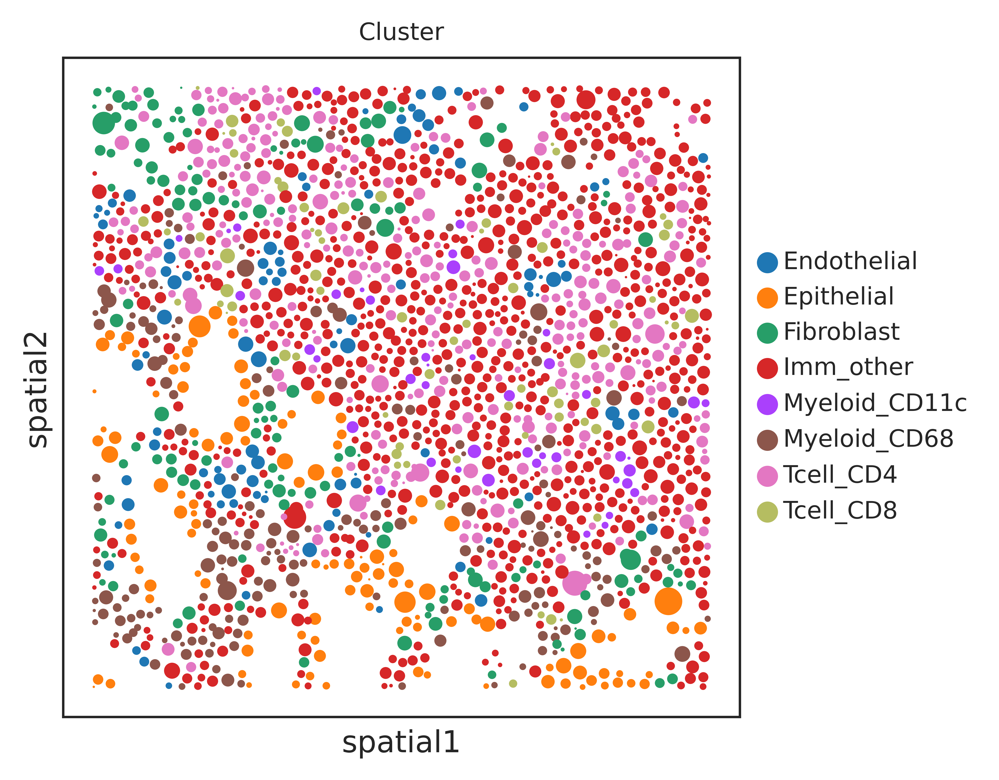

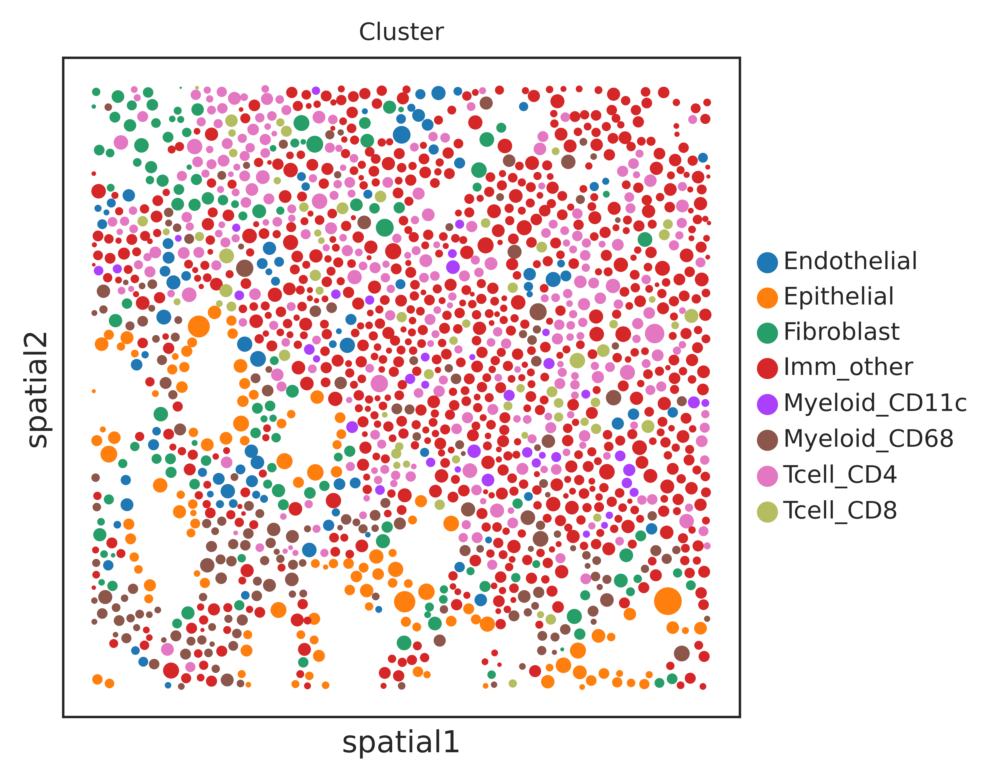

In [5]:

sc.pl.embedding(a_pixel,basis='spatial',color=['Cluster'],s=a_pixel.obs['cell_size']/10)
sc.pl.embedding(a_sc,basis='spatial',color=['Cluster'],s=a_sc.obs['cell_size']/10)

# comparison different representations in scMEP data

### prepare three mean representations

In [6]:
adata_all = a_pixel
adata_all.obsm['X_none'] = adata_all.X
adata_all.obsm['X_total'] = (adata_all.X+1)/(np.sum(adata_all.X,axis=1,keepdims=1)+1)
adata_all.obsm['X_median'] = (adata_all.X+1)/(np.median(adata_all.X,axis=1,keepdims=1)+1)


### run WB ratio for different representations and different nPCs

In [7]:
from sklearn.model_selection import *
from sklearn.neighbors import *
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier

run WB ratio result and keep IDs

In [8]:
pd_dict = {
    'rep':[],
    'WBR':[],
    'nPCs':[],
    'ne':[]
    
}
cls_use = 'Cluster'
# nPCs_range = range(10,210,10)
nPCs_range = range(5,40,5)

# nepochs_range = [5,10,20,30,40,50]
nepochs_range = [1,2,3,4,5]

for ne in nepochs_range:
#     print(i)
    
    SEAM.tl.ID(adata_all,epochs=ne,t=5,subsample=False,noise_mode=None,verbose=True)
    cur_ID_added = 'ID_e{0}'.format(ne)
    adata_all.obsm[cur_ID_added] = adata_all.obsm['ID'].copy()
    for nPCs in nPCs_range:
        print(ne,nPCs)
        print('running PCA')
        pca_ID = PCA(n_components=nPCs).fit_transform(adata_all.obsm['ID'])
        pca_X_none = PCA(n_components=nPCs).fit_transform(adata_all.obsm['X_none'])
        pca_X_total = PCA(n_components=nPCs).fit_transform(adata_all.obsm['X_total']) 
        pca_X_median = PCA(n_components=nPCs).fit_transform(adata_all.obsm['X_median']) 
        
        
        adata_all.obsm['pca{0}_{1}_e{2}'.format(nPCs,'ID',ne)] = pca_ID
        adata_all.obsm['pca{0}_{1}'.format(nPCs,'X_none')] = pca_X_none
        adata_all.obsm['pca{0}_{1}'.format(nPCs,'X_total')] = pca_X_total
        adata_all.obsm['pca{0}_{1}'.format(nPCs,'X_median')] = pca_X_median
        
        print('running WBR')
        WBR_ID = WBR_adata(adata_all[cell_match],'pca{0}_{1}_e{2}'.format(nPCs,'ID',ne),cls_use)
        WBR_X_none = WBR_adata(adata_all[cell_match],'pca{0}_{1}'.format(nPCs,'X_none'),cls_use)
        WBR_X_total = WBR_adata(adata_all[cell_match],'pca{0}_{1}'.format(nPCs,'X_total'),cls_use)        
        WBR_X_median = WBR_adata(adata_all[cell_match],'pca{0}_{1}'.format(nPCs,'X_median'),cls_use) 
        
          
        
        pd_dict['ne'].append(ne)
        pd_dict['rep'].append('ID')
        pd_dict['WBR'].append(WBR_ID)
        pd_dict['nPCs'].append(nPCs)
        
        pd_dict['ne'].append(ne)
        pd_dict['rep'].append('X_none')
        pd_dict['WBR'].append(WBR_X_none)
        pd_dict['nPCs'].append(nPCs)
        
        pd_dict['ne'].append(ne)
        pd_dict['rep'].append('X_total')
        pd_dict['WBR'].append(WBR_X_total)
        pd_dict['nPCs'].append(nPCs)
        
        pd_dict['ne'].append(ne)
        pd_dict['rep'].append('X_median')
        pd_dict['WBR'].append(WBR_X_median)
        pd_dict['nPCs'].append(nPCs)

running SIMS-ID...
Epoch 1/1
780250/780250 [==============================] - 198s 254us/step - loss: 6.5712 - softmax_loss: 6.5713 - center_loss: 27.0521
1 5
running PCA
running WBR
1 10
running PCA
running WBR
1 15
running PCA
running WBR
1 20
running PCA
running WBR
1 25
running PCA
running WBR
1 30
running PCA
running WBR
1 35
running PCA
running WBR
running SIMS-ID...
Epoch 1/2
780250/780250 [==============================] - 195s 250us/step - loss: 6.5941 - softmax_loss: 6.5941 - center_loss: 24.5359
Epoch 2/2
780250/780250 [==============================] - 195s 250us/step - loss: 6.2823 - softmax_loss: 6.2823 - center_loss: 23.7560
2 5
running PCA
running WBR
2 10
running PCA
running WBR
2 15
running PCA
running WBR
2 20
running PCA
running WBR
2 25
running PCA
running WBR
2 30
running PCA
running WBR
2 35
running PCA
running WBR
running SIMS-ID...
Epoch 1/3
780250/780250 [==============================] - 160s 205us/step - loss: 6.5879 - softmax_loss: 6.5879 - center_loss: 26.

上面虽然算了多个ne，但统计WBR的时候都统计了。
但是存了各种ne下的ID和pca，可以用下面的cell重新算WBR

In [10]:
# dump IDs
adata_all.write_h5ad('scMEP_p{0}/ID_compare_scMEP.h5ad'.format(Pn))

plot WBR result

In [11]:
import pickle
with open('scMEP_p{0}/unsupervised/ID_WBR_scMEP.pickle'.format(Pn), 'wb') as handle:
    pickle.dump(pd_dict, handle, protocol=pickle.HIGHEST_PROTOCOL)


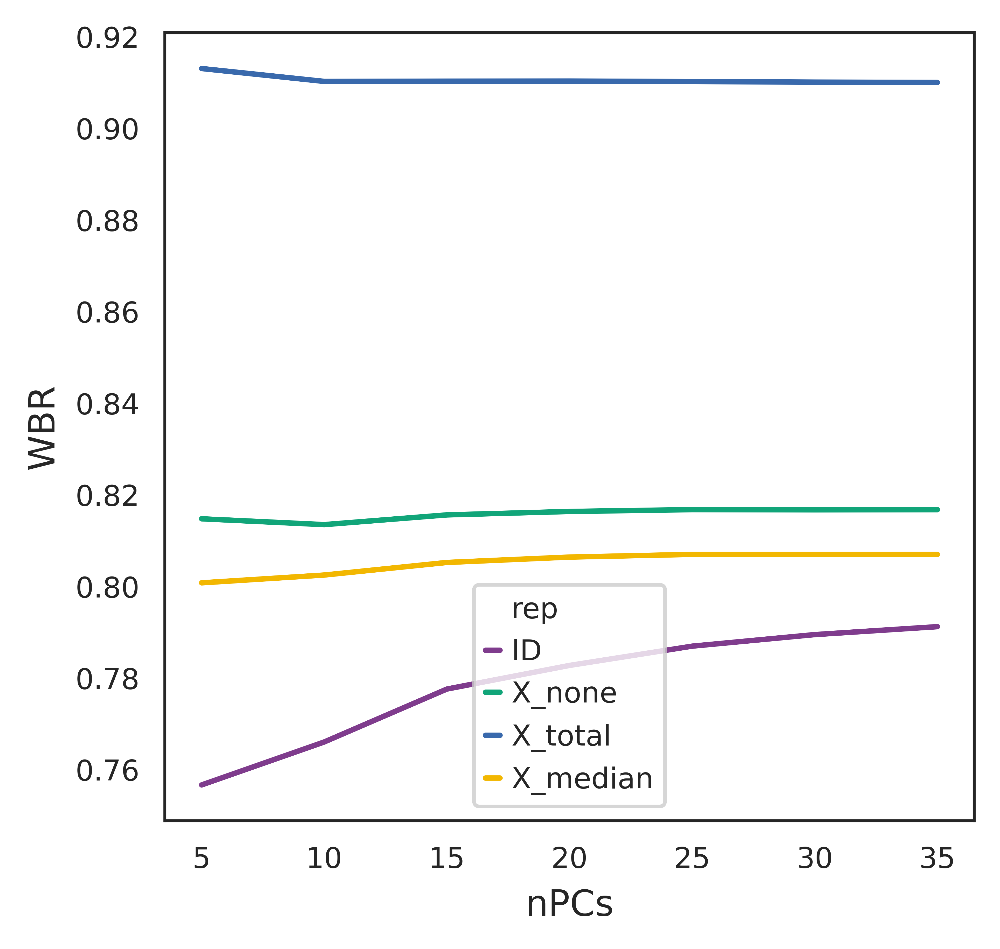

In [12]:
cur_cm = palettable.cartocolors.qualitative.Bold_4.mpl_colors
pd_df = pd.DataFrame(pd_dict)

ax = sns.lineplot(
    data=pd_df[pd_df['ne']==5], x="nPCs", y="WBR", hue="rep", err_style="bars", ci=68,
    palette = cur_cm
)
ax.figure.savefig("scMEP_p{0}/unsupervised/WBR_best_scMEP.png".format(Pn))

### run all classification 

In [13]:
pd_dict_classfication = {
    'classifier':[],
    'test_ratio':[],
    'Accuracy':[],
    'nPCs':[],
    'representation':[]
    
}
a_use = adata_all[cell_match]
cls_use = 'Cluster'
# test_nPCs_range = nPCs_range
test_nPCs_range = np.unique(pd_df.nPCs)

# rep_use = ['pca{0}_ID_e5'.format(test_nPCs),'pca{0}_X_none'.format(test_nPCs),
#            'pca{0}_X_total'.format(test_nPCs),'pca{0}_X_median'.format(test_nPCs)]
test_ratio_range = range(5,55,5)
# train_ratio_range = [5,10]

for i in range(10):
#     run for 10 replicates 
    for test_ratio in test_ratio_range:
        for nPCs in test_nPCs_range:
            rep_use = ['pca{0}_ID_e1'.format(nPCs),'pca{0}_ID_e2'.format(nPCs),
                       'pca{0}_ID_e3'.format(nPCs),'pca{0}_ID_e4'.format(nPCs),
                       'pca{0}_ID_e5'.format(nPCs),'pca{0}_X_none'.format(nPCs),
                   'pca{0}_X_total'.format(nPCs),'pca{0}_X_median'.format(nPCs)]
            for rep in rep_use:
                
                print(i,test_ratio,nPCs,rep)
                cur_KNN = KNN_adata(a_use,cls_use,rep,test_ratio)
                cur_SVM = SVM_adata(a_use,cls_use,rep,test_ratio)
                cur_RF = RF_adata(a_use,cls_use,rep,test_ratio)
                
                pd_dict_classfication['classifier'].append('KNN')
                pd_dict_classfication['test_ratio'].append(test_ratio)
                pd_dict_classfication['Accuracy'].append(cur_KNN)
                pd_dict_classfication['nPCs'].append(nPCs)
                pd_dict_classfication['representation'].append(rep)
                
               
                
                pd_dict_classfication['classifier'].append('SVM')
                pd_dict_classfication['test_ratio'].append(test_ratio)
                pd_dict_classfication['Accuracy'].append(cur_SVM)
                pd_dict_classfication['nPCs'].append(nPCs)
                pd_dict_classfication['representation'].append(rep)
                
                pd_dict_classfication['classifier'].append('RF')
                pd_dict_classfication['test_ratio'].append(test_ratio)
                pd_dict_classfication['Accuracy'].append(cur_RF)
                pd_dict_classfication['nPCs'].append(nPCs)
                pd_dict_classfication['representation'].append(rep)
                
                
                
                
                
                
                
    

0 5 5 pca5_ID_e1
pca5_ID_e1, KNN accuracy: 0.5677280550774527
pca5_ID_e1, SVM accuracy: 0.6091437177280552
pca5_ID_e1, RF accuracy: 0.6043244406196214
0 5 5 pca5_ID_e2
pca5_ID_e2, KNN accuracy: 0.5519650028686172
pca5_ID_e2, SVM accuracy: 0.5898809523809524
pca5_ID_e2, RF accuracy: 0.57842082616179
0 5 5 pca5_ID_e3
pca5_ID_e3, KNN accuracy: 0.574878083763626
pca5_ID_e3, SVM accuracy: 0.6212134251290878
pca5_ID_e3, RF accuracy: 0.6169391853126793
0 5 5 pca5_ID_e4
pca5_ID_e4, KNN accuracy: 0.5705895008605851
pca5_ID_e4, SVM accuracy: 0.5995410212277683
pca5_ID_e4, RF accuracy: 0.5850329890992542
0 5 5 pca5_ID_e5
pca5_ID_e5, KNN accuracy: 0.5916451520367183
pca5_ID_e5, SVM accuracy: 0.6139629948364889
pca5_ID_e5, RF accuracy: 0.5959480780263913
0 5 5 pca5_X_none
pca5_X_none, KNN accuracy: 0.5784566838783707
pca5_X_none, SVM accuracy: 0.6073938611589214
pca5_X_none, RF accuracy: 0.6055292598967298
0 5 5 pca5_X_total
pca5_X_total, KNN accuracy: 0.5856353987378082
pca5_X_total, SVM accuracy:

dump comparison results

In [14]:
import pickle
with open('scMEP_p{0}/classification/ID_classification_scMEP.pickle'.format(Pn), 'wb') as handle:
    pickle.dump(pd_dict_classfication, handle, protocol=pickle.HIGHEST_PROTOCOL)

# adata_all.write_h5ad('ID_compare_scMEP.h5ad')

plot all classification

In [ ]:
cur_cm = palettable.cartocolors.qualitative.Bold_8.mpl_colors
pd_df = pd.DataFrame(pd_dict_classfication)
representation_name = [s.split('_')[1]+'_'+s.split('_')[2] for s in  pd_df['representation']]
pd_df['representation'] = representation_name
# pd_df = pd_df[pd_df['nPCs']>=100]
# pd_df = pd_df[pd_df['classifier']!='RF']
for test_ratio in np.unique(pd_df['test_ratio']):
# for nPCs in [10,20]:

    g = sns.catplot(x="nPCs", y="Accuracy", hue="representation", col="classifier",
                    capsize=.2, palette=cur_cm, height=6, aspect=.75,
                    kind="point", data=pd_df[pd_df['test_ratio']==test_ratio])
    g.despine(left=True)
    g.savefig("scMEP_p{0}/classification/classification_test_ratio{1}_scMEP.png".format(Pn,test_ratio))
    
    

plot brief classification

In [ ]:
cur_cm = palettable.cartocolors.qualitative.Bold_5.mpl_colors
pd_df = pd.DataFrame(pd_dict_classfication)
representation_name = [s.split('_')[1]+'_'+s.split('_')[2] for s in  pd_df['representation']]
pd_df['representation'] = representation_name
rep_list_plot = ['ID_e5','X_none','X_total','X_median']
pd_df = pd_df[pd_df['representation'].isin(rep_list_plot)]
# pd_df = pd_df[pd_df['nPCs']>=100]
pd_df = pd_df[pd_df['classifier']!='RF']
for test_ratio in np.unique(pd_df['test_ratio']):
# for nPCs in [10,20]:

    g = sns.catplot(x="nPCs", y="Accuracy", hue="representation", col="classifier",
                    capsize=.2, palette=cur_cm, height=6, aspect=.75,
                    kind="point", data=pd_df[pd_df['test_ratio']==test_ratio])
    g.despine(left=True)
    g.savefig("scMEP_p{0}/classification/classification_brief_test_ratio{1}_scMEP.png".format(Pn,test_ratio))
    
    

### clustering 

simlr comparison

In [ ]:
import SIMLR
from sklearn.cluster import *
from sklearn.metrics import *
def simlr_wrap(X,k):
    simlr = SIMLR.SIMLR_LARGE(k, 10, 0) ###This is how we initialize an object for SIMLR. the first input is number of rank (clusters) and the second input is number of neighbors. The third one is an binary indicator whether to use memory-saving mode. you can turn it on when the number of cells are extremely large to save some memory but with the cost of efficiency.

    S, F,val, ind = simlr.fit(X)
#     print('Successfully Run SIMLR! SIMLR took %f seconds in total\n' % (time.time() -         start_main))
    pred_y = simlr.fast_minibatch_kmeans(F,k)
    return pred_y

In [ ]:
cls_use='Cluster'
pd_dict_clustering_simlr = {
    'rep':[],
    'res':[],
    'score':[],
    'score_type':[]
}
adata_use = adata_all[cell_match]
rep_list = ['pca35_X_none','pca35_X_total','pca35_X_median','pca35_ID_e5']
k_range = np.arange(3,15)
for rep in rep_list:
    for res in k_range:
        print(rep,res)
        cur_simlr = simlr_wrap(adata_use.obsm[rep],res)
        cur_nmi = normalized_mutual_info_score(adata_use.obs[cls_use],cur_simlr)
        cur_cs = completeness_score(adata_use.obs[cls_use],cur_simlr)
       
        rep_name = rep.split('_')[1]+'_'+rep.split('_')[2]
        
        pd_dict_clustering_simlr['rep'].append(rep_name)
        pd_dict_clustering_simlr['res'].append(res)     
        pd_dict_clustering_simlr['score'].append(cur_nmi) 
        pd_dict_clustering_simlr['score_type'].append('NMI')     
        

        pd_dict_clustering_simlr['rep'].append(rep_name)
        pd_dict_clustering_simlr['res'].append(res)     
        pd_dict_clustering_simlr['score'].append(cur_cs) 
        pd_dict_clustering_simlr['score_type'].append('CS')     
        
    
        
        
     


In [43]:
cur_cm = palettable.cartocolors.qualitative.Bold_4.mpl_colors

pd_df_clustering = pd.DataFrame(pd_dict_clustering_simlr)
g = sns.catplot(x="res", y="score", hue="rep", col="score_type",
                hue_order=['ID_e5','X_none','X_total','X_median'],
                capsize=.2, palette=cur_cm, height=6, aspect=.75,
                kind="point", data=pd_df_clustering)
g.despine(left=True)
g.fig.suptitle('SIMLR', fontsize=16)
g.savefig("scMEP_p{0}/unsupervised/clustering_simlr_best_scMEP.png".format(Pn))


In [44]:
for rep in rep_list:
    cur_np = pd_df_clustering[pd_df_clustering['rep']==rep]
    print(rep)
    for ST in np.unique(cur_np['score_type']):
        cur_score_np = cur_np[cur_np['score_type']==ST]
        cur_rep_score = cur_score_np['score']
        print('\t {0}: {1} {2} {3}'.format(ST,np.max(cur_rep_score),np.mean(cur_rep_score),np.median(cur_rep_score)))
    
    
    

X_none
	 CS: 0.20036198164522787 0.17385010223605504 0.17479082615781497
	 NMI: 0.21672874634588676 0.18993110633435575 0.20494388135346786
X_total
	 CS: 0.18191701022506263 0.16300064526464855 0.16482428536709193
	 NMI: 0.20236119942714487 0.17598211911779393 0.1864294894650486
X_median
	 CS: 0.20551853425835098 0.1822413105076566 0.1811609698533275
	 NMI: 0.2115533814206799 0.19516436174126803 0.1983040923990045
ID_e5
	 CS: 0.28806039036781267 0.2250373847587288 0.20790325244430138
	 NMI: 0.24568036441977728 0.22507454153117748 0.22649579836030295


In [ ]:
import pickle
with open('scMEP_p{0}/unsupervised/ID_clustering_simlr_scMEP.pickle'.format(Pn), 'wb') as handle:
    pickle.dump(pd_dict_clustering_simlr, handle, protocol=pickle.HIGHEST_PROTOCOL)



Kmeans comparison

In [ ]:
pd_dict_clustering_kmeans = {
    'rep':[],
    'res':[],
    'score':[],
    'score_type':[]
}
# rep_list = ['X_none','X_total','X_median','ID_e5']
rep_list = ['pca35_X_none','pca35_X_total','pca35_X_median','pca35_ID_e5']
adata_use = adata_all[cell_match]
# k_range = np.arange(10,30)
k_range = np.arange(3,15)

for rep in rep_list:
    for res in k_range:
        print(rep,res)
        cur_kmeans = KMeans(n_clusters=res).fit_predict(adata_use.obsm[rep])
        cur_nmi = normalized_mutual_info_score(adata_use.obs[cls_use],cur_kmeans)
        cur_cs = completeness_score(adata_use.obs[cls_use],cur_kmeans)
       
        
        
        pd_dict_clustering_kmeans['rep'].append(rep)
        pd_dict_clustering_kmeans['res'].append(res)     
        pd_dict_clustering_kmeans['score'].append(cur_nmi) 
        pd_dict_clustering_kmeans['score_type'].append('NMI')     
        

        pd_dict_clustering_kmeans['rep'].append(rep)
        pd_dict_clustering_kmeans['res'].append(res)     
        pd_dict_clustering_kmeans['score'].append(cur_cs) 
        pd_dict_clustering_kmeans['score_type'].append('CS')     
        
    
        
        
     


In [52]:
cur_cm = palettable.cartocolors.qualitative.Bold_4.mpl_colors

pd_df_clustering = pd.DataFrame(pd_dict_clustering_kmeans)
g = sns.catplot(x="res", y="score", hue="rep", col="score_type",
                hue_order=['pca35_ID_e5','pca35_X_none','pca35_X_total','pca35_X_median'],
                capsize=.2, palette=cur_cm, height=6, aspect=.75,
                kind="point", data=pd_df_clustering)
g.despine(left=True)
g.savefig("scMEP_p{0}/unsupervised/clustering_kmeans_best_scMEP.png".format(Pn))


In [53]:
for rep in ['pca35_ID_e5','pca35_X_none','pca35_X_total','pca35_X_median']:
            
    cur_np = pd_df_clustering[pd_df_clustering['rep']==rep]
    print(rep)
    for ST in np.unique(cur_np['score_type']):
        cur_score_np = cur_np[cur_np['score_type']==ST]
        cur_rep_score = cur_score_np['score']
        print('\t {0}: {1} {2} {3}'.format(ST,np.max(cur_rep_score),np.mean(cur_rep_score),np.median(cur_rep_score)))
    
    
    

pca35_ID_e5
	 CS: 0.3086830105344373 0.23715828316877433 0.23179630091327436
	 NMI: 0.2794173923395481 0.24332649418513108 0.23558362110681796
pca35_X_none
	 CS: 0.199186321727492 0.1836348385632148 0.18090213486182052
	 NMI: 0.22133806862134192 0.19528921983391323 0.20614987911290966
pca35_X_total
	 CS: 0.14544922855631337 0.10914005023407282 0.11231204065093539
	 NMI: 0.17140531867527795 0.11562858392125673 0.11994729505308369
pca35_X_median
	 CS: 0.22217552127992257 0.19250791449033625 0.1883714754126905
	 NMI: 0.22496914516585997 0.2041565274161691 0.21020513570096622


In [ ]:
import pickle
with open('scMEP_p{0}/unsupervised/ID_clustering_kmeans_scMEP.pickle'.format(Pn), 'wb') as handle:
    pickle.dump(pd_dict_clustering_kmeans, handle, protocol=pickle.HIGHEST_PROTOCOL)



louvain comparison

In [42]:
1+1

2

In [ ]:
cls_use = 'Cluster'
adata_use = adata_all[cell_match]
pd_dict_clustering_louvain = {
    'rep':[],
    'res':[],
    'score':[],
    'score_type':[]
}
rep_list = ['X_none','X_total','X_median','ID_e5']
# rep_list = ['pca10_X_none','pca10_X_total','pca10_X_median','pca10_ID_e5']

res_range = np.arange(0.5,10,0.5)
for rep in rep_list:
    neighbors_key = 'neighbors_{0}'.format(rep)
    sc.pp.neighbors(adata_use,use_rep=rep,key_added=neighbors_key)
    for res in res_range:
        print(rep,res)
        cur_key = 'louvain_{0}_res{1}'.format(rep,res)
        sc.tl.louvain(adata_use,neighbors_key=neighbors_key,resolution=res,key_added=cur_key)
        cur_nmi = normalized_mutual_info_score(adata_use.obs[cls_use],adata_use.obs[cur_key])
        cur_cs = completeness_score(adata_use.obs[cls_use],adata_use.obs[cur_key])
       
        
        
        pd_dict_clustering_louvain['rep'].append(rep)
        pd_dict_clustering_louvain['res'].append(res)     
        pd_dict_clustering_louvain['score'].append(cur_nmi) 
        pd_dict_clustering_louvain['score_type'].append('NMI')     
        

        pd_dict_clustering_louvain['rep'].append(rep)
        pd_dict_clustering_louvain['res'].append(res)     
        pd_dict_clustering_louvain['score'].append(cur_cs) 
        pd_dict_clustering_louvain['score_type'].append('CS')     
        
    
        
        
     


plot clustering result

In [47]:
cur_cm = palettable.cartocolors.qualitative.Bold_4.mpl_colors

pd_df_clustering = pd.DataFrame(pd_dict_clustering_louvain)
g = sns.catplot(x="res", y="score", hue="rep", col="score_type",
                hue_order=['ID_e5','X_none','X_total','X_median'],
#                 hue_order = ['X_none','X_total','X_median','ID_e5'],
                
                capsize=.2, palette=cur_cm, height=6, aspect=.75,
                kind="point", data=pd_df_clustering)
g.despine(left=True)
g.savefig("scMEP_p{0}/unsupervised/clustering_louvain_best_scMEP.png".format(Pn))


In [48]:
for rep in rep_list:
    cur_np = pd_df_clustering[pd_df_clustering['rep']==rep]
    print(rep)
    for ST in np.unique(cur_np['score_type']):
        cur_score_np = cur_np[cur_np['score_type']==ST]
        cur_rep_score = cur_score_np['score']
        print('\t {0}: {1} {2} {3}'.format(ST,np.max(cur_rep_score),np.mean(cur_rep_score),np.median(cur_rep_score)))
    
    
    

X_none
	 CS: 0.21125518784506267 0.17197461446105344 0.1670074919063946
	 NMI: 0.23295318346352073 0.2286426999331321 0.2294818649793058
X_total
	 CS: 0.17037236821960156 0.15028440020548967 0.14999147185910536
	 NMI: 0.2188352085010742 0.20116311772490403 0.20292421433151225
X_median
	 CS: 0.21650936771163187 0.16960016903256703 0.16409833560159792
	 NMI: 0.23322814019906704 0.22565665662121148 0.22658525124862813
ID_e5
	 CS: 0.2612044075727305 0.19988416539098575 0.19331255928167043
	 NMI: 0.2804630862852674 0.2659404406591846 0.2673947035683753


In [ ]:
import pickle
with open('scMEP_p{0}/unsupervised/ID_clustering_louvain_scMEP.pickle'.format(Pn), 'wb') as handle:
    pickle.dump(pd_dict_clustering_louvain, handle, protocol=pickle.HIGHEST_PROTOCOL)



leiden comparison

In [ ]:
pd_dict_clustering_leiden = {
    'rep':[],
    'res':[],
    'score':[],
    'score_type':[]
}
adata_use = adata_all[cell_match]
# rep_list = ['X_none','X_total','X_median','ID_e5']
# rep_list = ['pca10_X_none','pca10_X_total','pca10_X_median','pca10_ID_e5']
rep_list = ['X_none','X_total','X_median','ID_e5']


res_range = np.arange(0.5,10,0.5)
for rep in rep_list:
    neighbors_key = 'neighbors_{0}'.format(rep)
    sc.pp.neighbors(adata_use,use_rep=rep,key_added=neighbors_key)
    for res in res_range:
        print(rep,res)
        cur_key = 'leiden_{0}_res{1}'.format(rep,res)
        sc.tl.leiden(adata_use,neighbors_key=neighbors_key,resolution=res,key_added=cur_key)
        cur_nmi = normalized_mutual_info_score(adata_use.obs[cls_use],adata_use.obs[cur_key])
        cur_cs = completeness_score(adata_use.obs[cls_use],adata_use.obs[cur_key])
       
        
        
        pd_dict_clustering_leiden['rep'].append(rep)
        pd_dict_clustering_leiden['res'].append(res)     
        pd_dict_clustering_leiden['score'].append(cur_nmi) 
        pd_dict_clustering_leiden['score_type'].append('NMI')     
        

        pd_dict_clustering_leiden['rep'].append(rep)
        pd_dict_clustering_leiden['res'].append(res)     
        pd_dict_clustering_leiden['score'].append(cur_cs) 
        pd_dict_clustering_leiden['score_type'].append('CS')     
        
    
        
        
     


In [49]:
cur_cm = palettable.cartocolors.qualitative.Bold_4.mpl_colors

pd_df_clustering = pd.DataFrame(pd_dict_clustering_leiden)
g = sns.catplot(x="res", y="score", hue="rep", col="score_type",
                hue_order=['ID_e5','X_none','X_total','X_median'],
#                 hue_order = ['X_none','X_total','X_median','ID_e1','ID_e2','ID_e3','ID_e4','ID_e5'],
                
                capsize=.2, palette=cur_cm, height=6, aspect=.75,
                kind="point", data=pd_df_clustering)
g.despine(left=True)
g.savefig("scMEP_p{0}/unsupervised/clustering_leiden_best_scMEP.png".format(Pn))


In [50]:
for rep in rep_list:
    cur_np = pd_df_clustering[pd_df_clustering['rep']==rep]
    print(rep)
    for ST in np.unique(cur_np['score_type']):
        cur_score_np = cur_np[cur_np['score_type']==ST]
        cur_rep_score = cur_score_np['score']
        print('\t {0}: {1} {2} {3}'.format(ST,np.max(cur_rep_score),np.mean(cur_rep_score),np.median(cur_rep_score)))
    
    
    

X_none
	 CS: 0.2433180414256187 0.17245820957337435 0.16557561548350525
	 NMI: 0.24672976955821374 0.23192846218176869 0.23146095149770773
X_total
	 CS: 0.1851774703211995 0.1565844293567885 0.15411794319204367
	 NMI: 0.2257138305725595 0.21330787556417563 0.21311215994793198
X_median
	 CS: 0.210666435355405 0.16926552589848756 0.16480476750697254
	 NMI: 0.23359775300706564 0.229266648635466 0.2295244045205862
ID_e5
	 CS: 0.26734573386050436 0.1965104496127249 0.1900146763861283
	 NMI: 0.27328421109431933 0.26405148755138474 0.2665399506570029


In [ ]:
import pickle
with open('scMEP_p{0}/unsupervised/ID_clustering_leiden_scMEP.pickle'.format(Pn), 'wb') as handle:
    pickle.dump(pd_dict_clustering_leiden, handle, protocol=pickle.HIGHEST_PROTOCOL)



In [ ]:
from sklearn.model_selection import *
from sklearn.neighbors import *
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier

In [ ]:
adata_all.shape

In [ ]:
sc.pp.neighbors(adata_use,use_rep='ID_e5',metric='cosine')
sc.tl.umap(adata_use)
sc.pl.umap(adata_use,color=['Cluster'])
sc.tl.leiden(adata_use)
normalized_mutual_info_score(adata_use.obs['Cluster'],adata_use.obs['leiden'])

In [ ]:
sc.pp.log1p(adata_use)
sc.pp.normalize_total(adata_use)
sc.pp.neighbors(adata_use)
sc.tl.umap(adata_use)
sc.pl.umap(adata_use,color=['Cluster'])
sc.tl.leiden(adata_use)
normalized_mutual_info_score(adata_use.obs['Cluster'],adata_use.obs['leiden'])

In [ ]:
sc.pp.neighbors(adata_use,use_rep='ID_e5',metric='cosine')
sc.tl.umap(adata_use)
sc.pl.umap(adata_use,color=['Cluster'])
sc.tl.leiden(adata_use)
normalized_mutual_info_score(adata_use.obs['Cluster'],adata_use.obs['leiden'])

In [ ]:
sc.pp.neighbors(adata_use,use_rep='ID_e5',metric='euclidean')
sc.tl.umap(adata_use)
sc.pl.umap(adata_use,color=['Cluster'])
sc.tl.leiden(adata_use)
normalized_mutual_info_score(adata_use.obs['Cluster'],adata_use.obs['leiden'])